# 1. Building the project

## 1.1 Install requirements


In [28]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [3]:
!gdown 1msLVo0g0LFmL9-qZ73vq9YEVZwbzOePF&fbclid=IwY2xjawEb1sRleHRuA2FlbQIxMAABHSJASOq2J1yjWwPVUbUXhLz0LpkInMcQdYTq-XO-r4_cv4iXWiosSg3KAw_aem_wS6Ybb_gF0oxrMTwWGzabA

Downloading...
From (original): https://drive.google.com/uc?id=1msLVo0g0LFmL9-qZ73vq9YEVZwbzOePF
From (redirected): https://drive.google.com/uc?id=1msLVo0g0LFmL9-qZ73vq9YEVZwbzOePF&confirm=t&uuid=cfb05941-76c6-4da0-92fc-ca4e53e2f2a0
To: /content/data.zip
100% 76.1M/76.1M [00:04<00:00, 19.0MB/s]


In [4]:
!unzip data.zip

Archive:  data.zip
   creating: data/
   creating: data/.ipynb_checkpoints/
   creating: data/test/
   creating: data/test/American_egret/
  inflating: data/test/American_egret/n02009912_2473.JPEG  
   creating: data/test/Doberman/
  inflating: data/test/Doberman/n02107142_52285.JPEG  
   creating: data/test/Rhodesian_ridgeback/
  inflating: data/test/Rhodesian_ridgeback/n02087394_18723.JPEG  
   creating: data/test/African_crocodile/
  inflating: data/test/African_crocodile/n01697457_18534.JPEG  
   creating: data/test/Lakeland_terrier/
  inflating: data/test/Lakeland_terrier/n02095570_4644.JPEG  
   creating: data/test/ambulance/
  inflating: data/test/ambulance/n02701002_2311.JPEG  
   creating: data/test/apiary/
  inflating: data/test/apiary/n02727426_4398.JPEG  
   creating: data/test/bannister/
  inflating: data/test/bannister/n02788148_47071.JPEG  
   creating: data/test/basketball/
  inflating: data/test/basketball/n02802426_12693.JPEG  
   creating: data/test/barn_spider/
  in

## 1.2 Necessary function

In [5]:
# Get a list of image classes in data
ROOT = 'data'
CLASS_NAME = sorted(list(os.listdir(f'{ROOT}/train')))

In [13]:
def plot_results(querquery_pathy, ls_path_score, reverse):
    fig = plt.figure(figsize=(15, 9))
    fig.add_subplot(2, 3, 1)
    plt.imshow(read_image_from_path(querquery_pathy, size=(448,448)))
    plt.title(f"Query Image: {querquery_pathy.split('/')[2]}", fontsize=16)
    plt.axis("off")
    for i, path in enumerate(sorted(ls_path_score, key=lambda x : x[1], reverse=reverse)[:5], 2):
        fig.add_subplot(2, 3, i)
        plt.imshow(read_image_from_path(path[0], size=(448,448)))
        plt.title(f"Top {i-1}: {path[0].split('/')[2]}", fontsize=16)
        plt.axis("off")
    plt.show()

In [7]:
def read_image_from_path(path, size):
  im = Image.open(path).convert('RGB').resize(size)

  return np.array(im)

def folder_to_images(folder, size):
  list_dir = [folder + '/' + name for name in os.listdir(folder)]
  images_np = np.zeros(shape=(len(list_dir), *size, 3))
  images_path = []

  for i, path in enumerate(list_dir):
    images_np[i] = read_image_from_path(path, size)
    images_path.append(path)
  images_path = np.array(images_path)

  return images_np, images_path

## 1.3 L1 measure (Absolute difference)

In [9]:
# Using L1
def absolute_difference(query, data):
  axis_batch_size = tuple(range(1, len(data.shape)))
  return np.sum(np.abs(data - query), axis=axis_batch_size)

In [10]:
def get_l1_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  ls_path_score = []

  for folder in os.listdir(root_img_path):

    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      rates = absolute_difference(query, images_np)
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

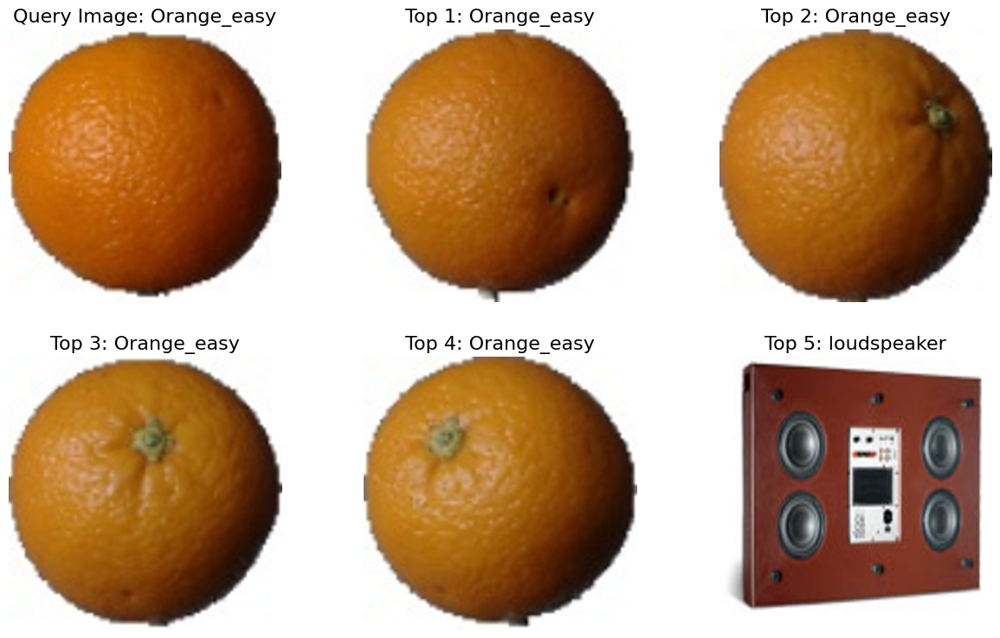

In [14]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_l1_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

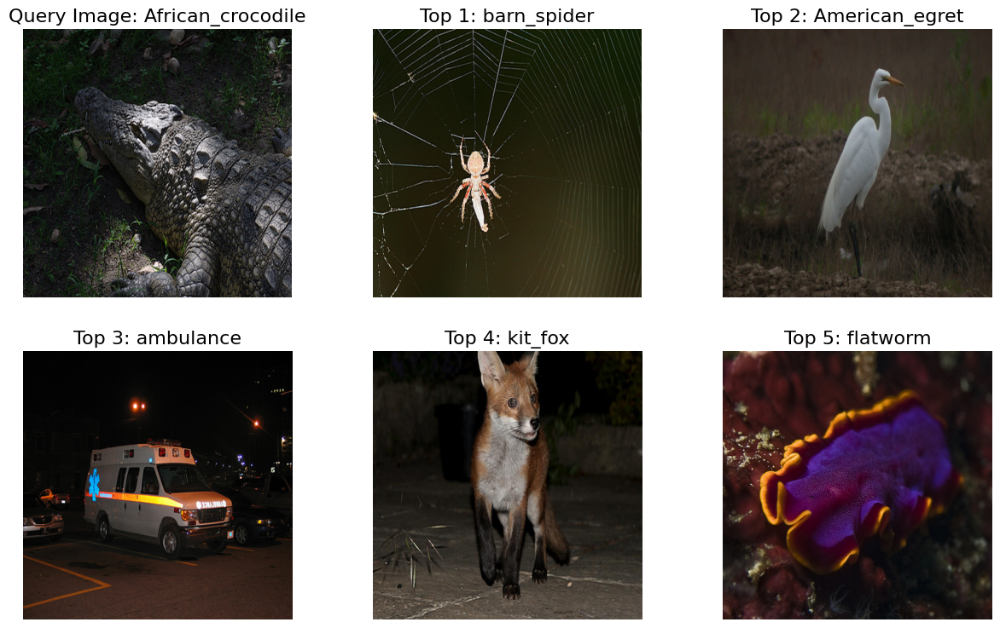

In [15]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_l1_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

## 1.4 L2 measure (Mean Square difference)

In [16]:
def mean_squared_difference(query, data):
  axis_batch_size = tuple(range(1, len(data.shape)))

  return np.mean((data - query)**2, axis=axis_batch_size)

In [17]:
def get_l2_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  ls_path_score = []

  for folder in os.listdir(root_img_path):

    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      rates = mean_squared_difference(query, images_np)
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

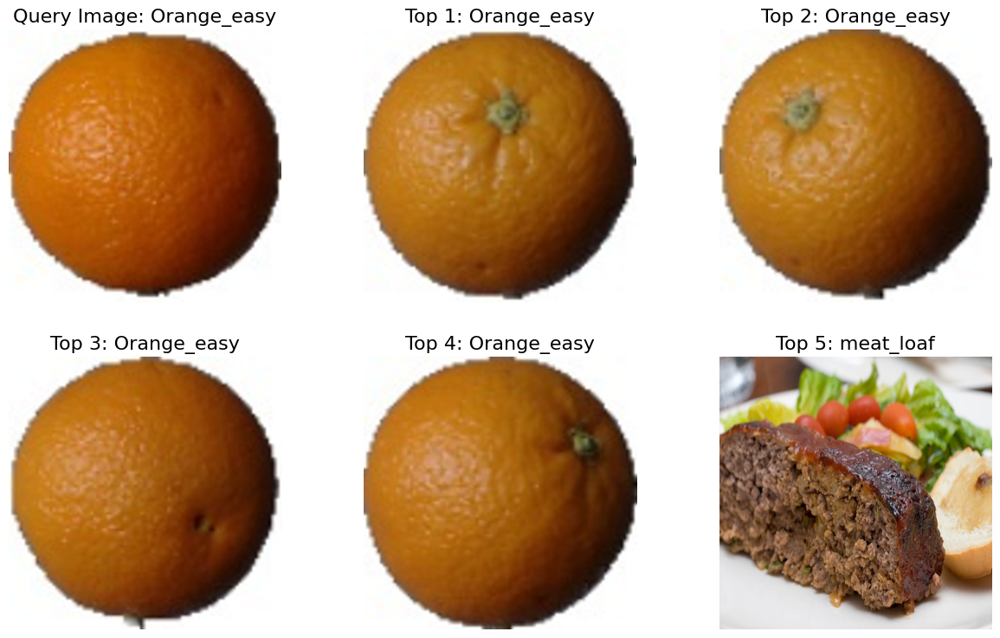

In [19]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_l2_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

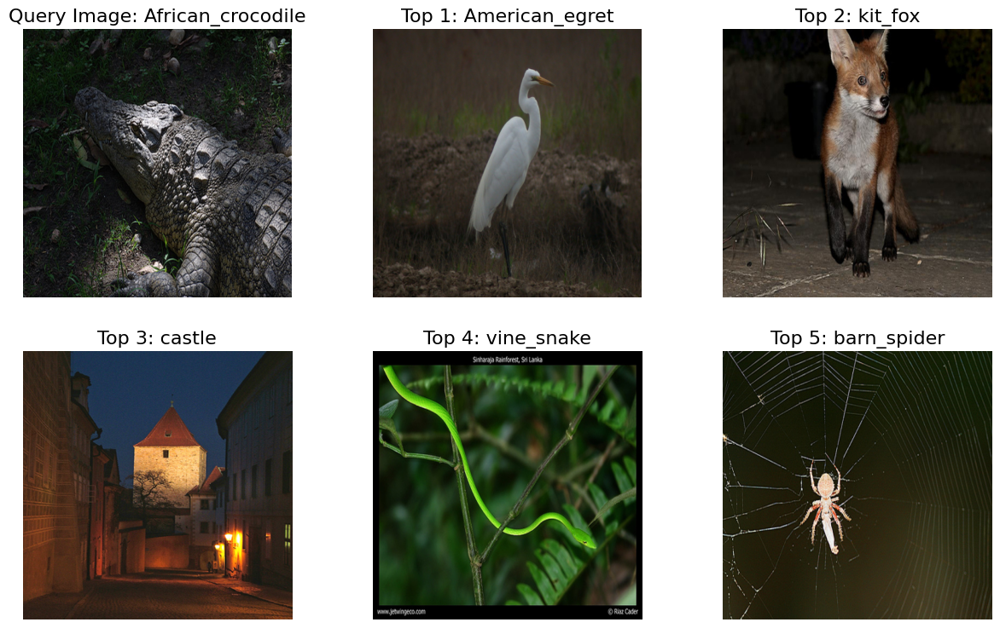

In [20]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_l2_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

## 1.5 Cosine Similarity

In [57]:
# Using Cosine Similarity
def cosine_similarity(query, data):
    query = np.array(query)
    data = np.array(data)

    axis_batch_size = tuple(range(1, len(data.shape)))

    query_norm = np.sqrt(np.sum(query**2))
    data_norm = np.sqrt(np.sum(data**2, axis=axis_batch_size))

    return np.sum(data * query, axis=axis_batch_size) / (query_norm * data_norm + np.finfo(float).eps)

In [21]:
def get_cosine_similarity_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  ls_path_score = []

  for folder in os.listdir(root_img_path):

    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      rates =  cosine_similarity(query, images_np)
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

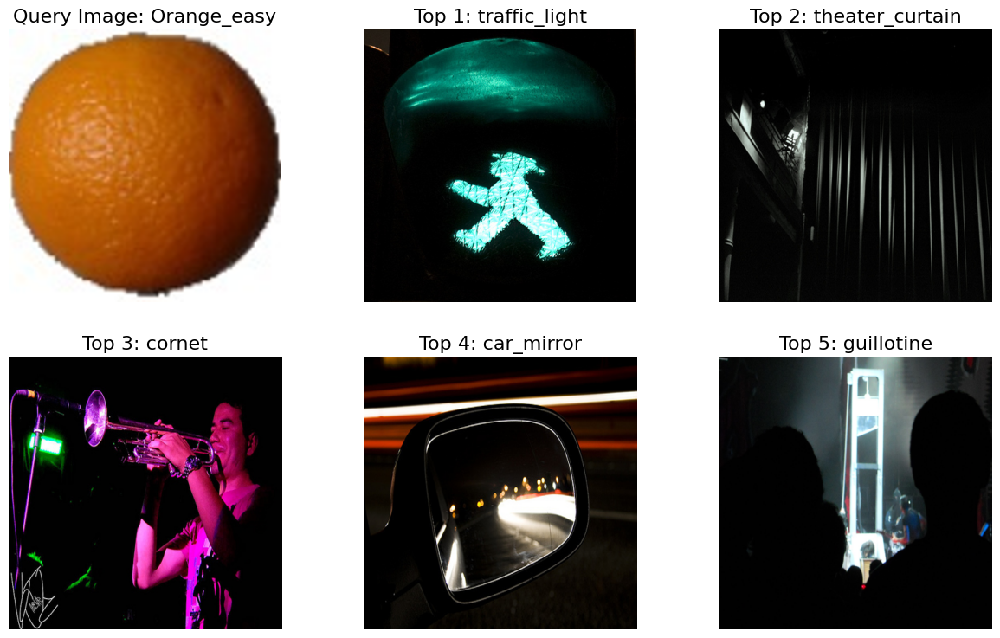

In [22]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_cosine_similarity_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

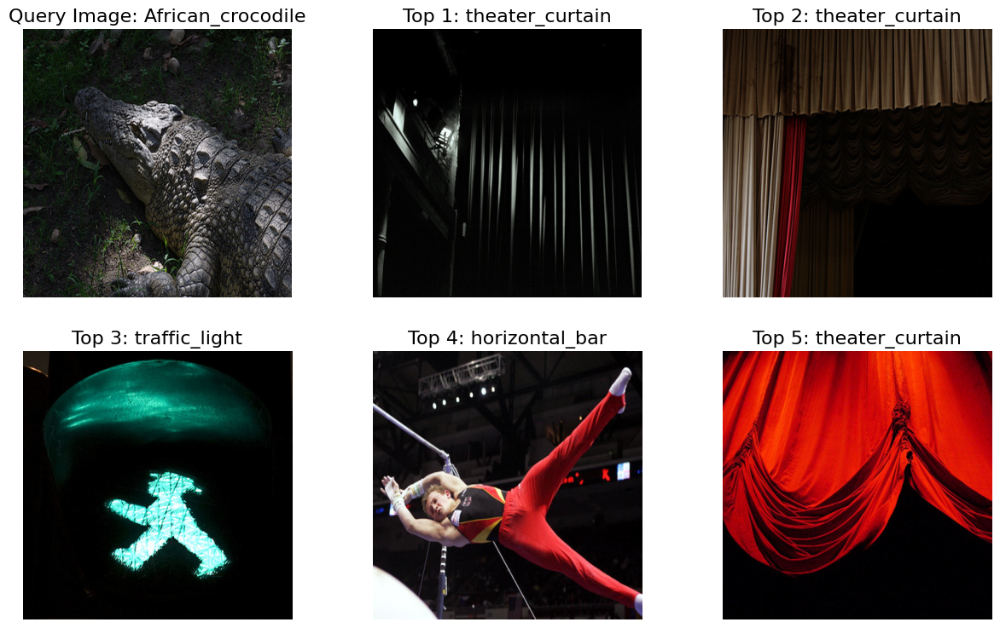

In [23]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_cosine_similarity_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

## 1.6 Correlation Coefficient

In [24]:
def correlation_coefficient(query, data):
  axis_batch_size = tuple(range(1, len(data.shape)))
  query_mean = query - np.mean(query)
  data_mean = data - np.mean(data, axis = axis_batch_size, keepdims=True)
  query_norm = np.sqrt(np.sum(query_mean**2))
  data_norm = np.sqrt(np.sum(data_mean**2, axis=axis_batch_size))

  return np.sum(data_mean * query_mean, axis=axis_batch_size) / (query_norm * data_norm + np.finfo(float).eps)

In [25]:
def get_correlation_coefficient_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  ls_path_score = []

  for folder in os.listdir(root_img_path):

    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      rates = correlation_coefficient(query, images_np)
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

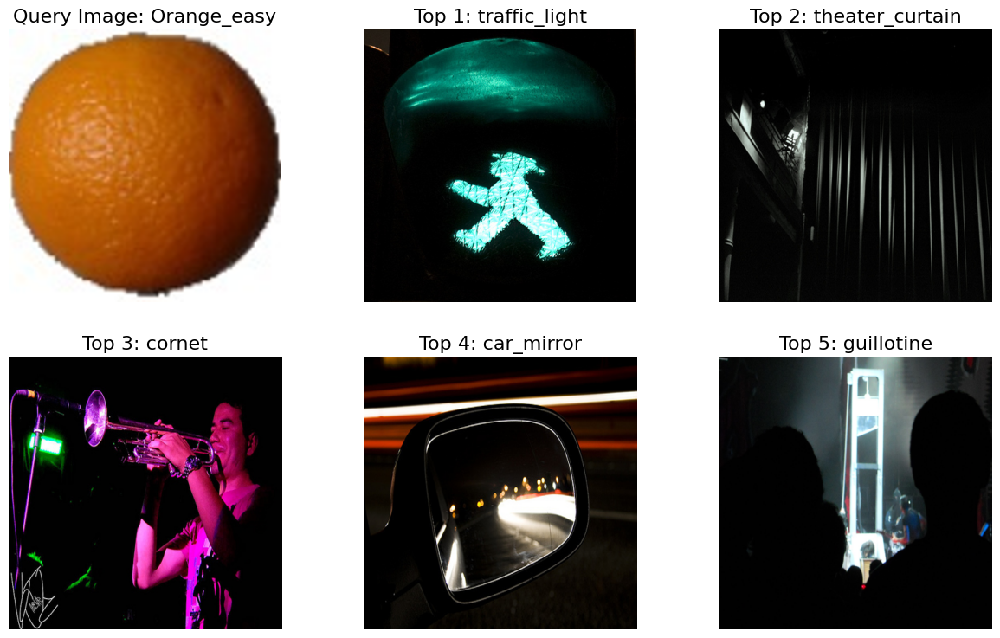

In [26]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_cosine_similarity_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

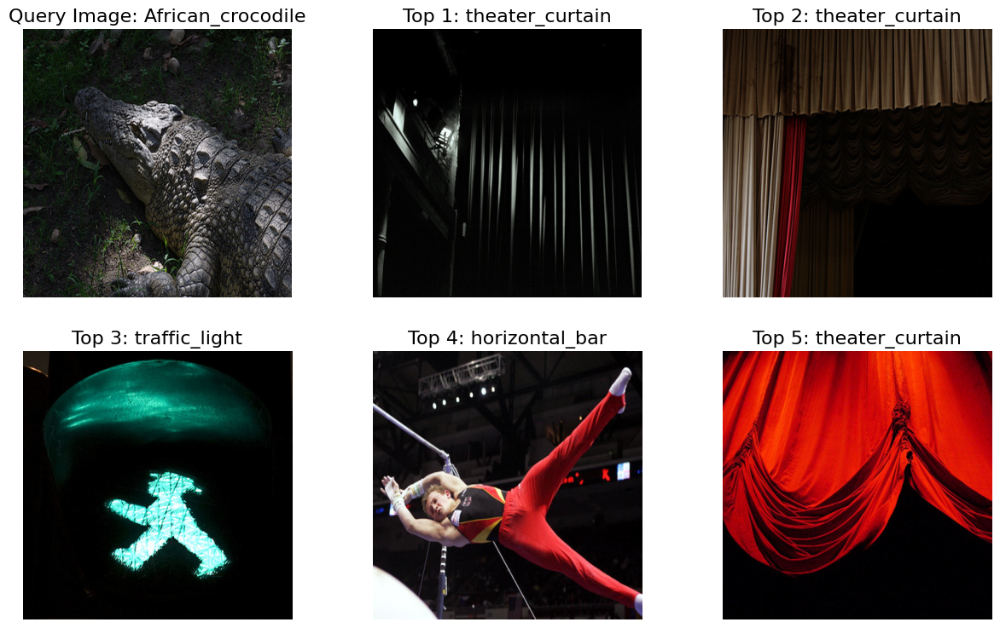

In [27]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_cosine_similarity_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

# 2. Bulding advance project

## 2.1 Install requirements

In [29]:
!pip install chromadb
!pip install open-clip-torch

In [31]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from chromadb.utils.embedding_functions import OpenCLIPEmbeddingFunction

## 2.2 Necessary function

In [32]:
embedding_function = OpenCLIPEmbeddingFunction()

def get_single_image_embedding(image):
    embedding = embedding_function._encode_image(image=np.array(image))
    return embedding

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


open_clip_pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

In [33]:
def plot_results(querquery_pathy, ls_path_score, reverse):
    fig = plt.figure(figsize=(15, 9))
    fig.add_subplot(2, 3, 1)
    plt.imshow(read_image_from_path(querquery_pathy, size=(448,448)))
    plt.title(f"Query Image: {querquery_pathy.split('/')[2]}", fontsize=16)
    plt.axis("off")
    for i, path in enumerate(sorted(ls_path_score, key=lambda x : x[1], reverse=reverse)[:5], 2):
        fig.add_subplot(2, 3, i)
        plt.imshow(read_image_from_path(path[0], size=(448,448)))
        plt.title(f"Top {i-1}: {path[0].split('/')[2]}", fontsize=16)
        plt.axis("off")
    plt.show()

## 2.3 Update get_l1_score function

In [34]:
def get_l1_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  query_embedding = get_single_image_embedding(query)
  ls_path_score = []

  for folder in os.listdir(root_img_path):

    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      embedding_list = []

      for idx_img in range(images_np.shape[0]):
        embedding = get_single_image_embedding(images_np[idx_img].astype(np.uint8))
        embedding_list.append(embedding)

      rates = absolute_difference(query_embedding, np.stack(embedding_list))
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

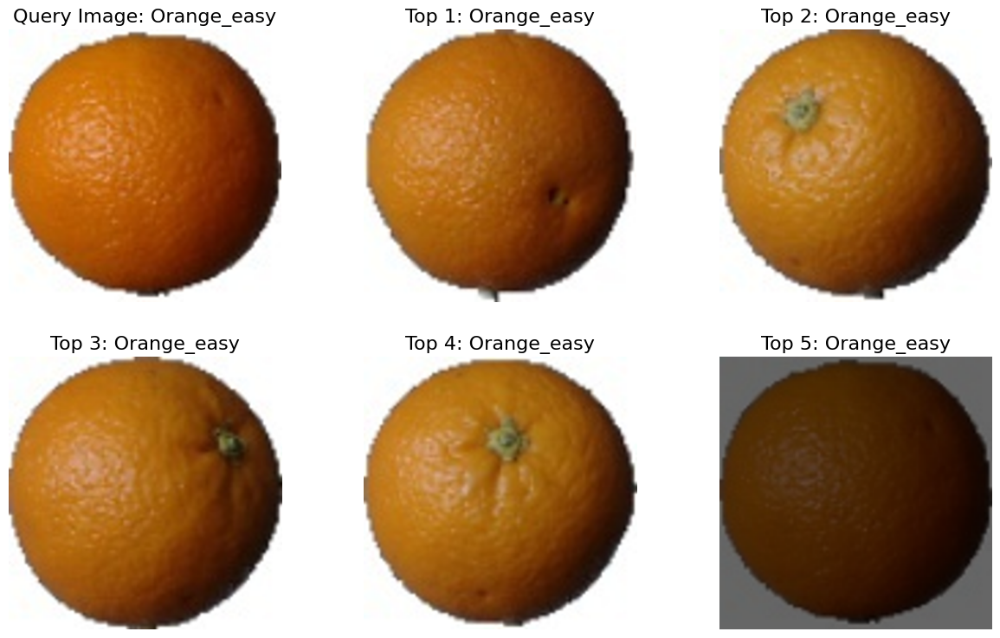

In [35]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_l1_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

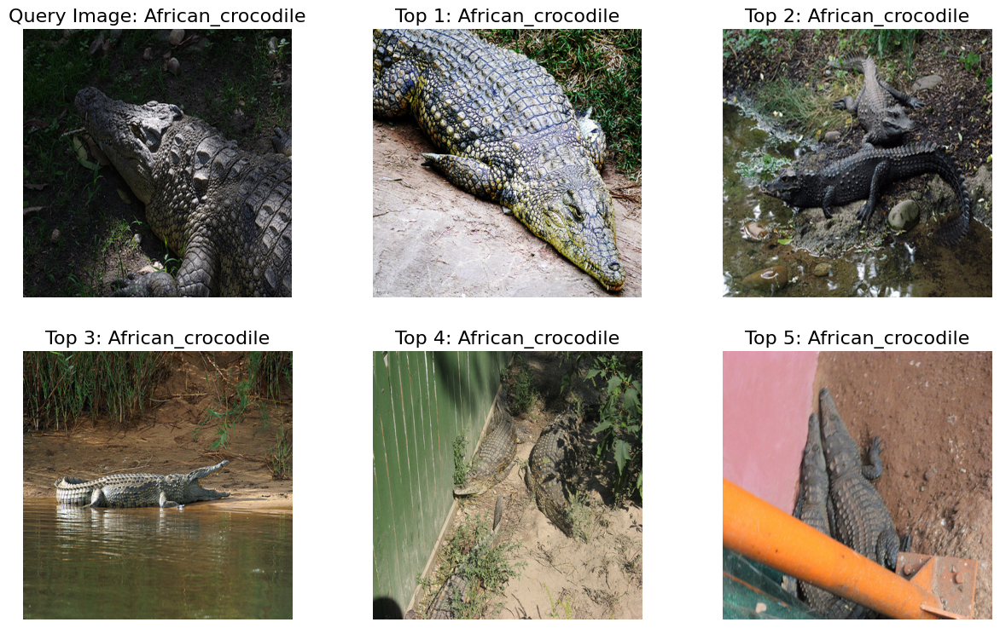

In [36]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_l1_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

In [38]:
sorted(ls_path_score, key=lambda x: x[1])

[('data/train/African_crocodile/n01697457_10393.JPEG', 9.512794798713003),
 ('data/train/African_crocodile/n01697457_5586.JPEG', 10.202179404433991),
 ('data/train/African_crocodile/n01697457_14906.JPEG', 11.992315275901944),
 ('data/train/African_crocodile/n01697457_1331.JPEG', 12.823920340902987),
 ('data/train/African_crocodile/n01697457_260.JPEG', 12.857385652961966),
 ('data/train/African_crocodile/n01697457_85.JPEG', 13.500170971950865),
 ('data/train/African_crocodile/n01697457_18587.JPEG', 14.238459376487299),
 ('data/train/African_crocodile/n01697457_8136.JPEG', 14.596684491290034),
 ('data/train/ruffed_grouse/n01797886_17360.JPEG', 14.6718010377881),
 ('data/train/vine_snake/n01739381_5304.JPEG', 15.407663093130395),
 ('data/train/vine_snake/n01739381_5091.JPEG', 15.759098163001909),
 ('data/train/vine_snake/n01739381_5245.JPEG', 15.784385994265904),
 ('data/train/triceratops/n01704323_2435.JPEG', 15.979116883201641),
 ('data/train/triceratops/n01704323_541.JPEG', 15.98559925

## 2.4 Update get_l2_score function

In [37]:
def get_l2_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  query_embedding = get_single_image_embedding(query)
  ls_path_score = []

  for folder in os.listdir(root_img_path):

    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      embedding_list = []

      for idx_img in range(images_np.shape[0]):
        embedding = get_single_image_embedding(images_np[idx_img].astype(np.uint8))
        embedding_list.append(embedding)

      rates = mean_squared_difference(query_embedding, np.stack(embedding_list))
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

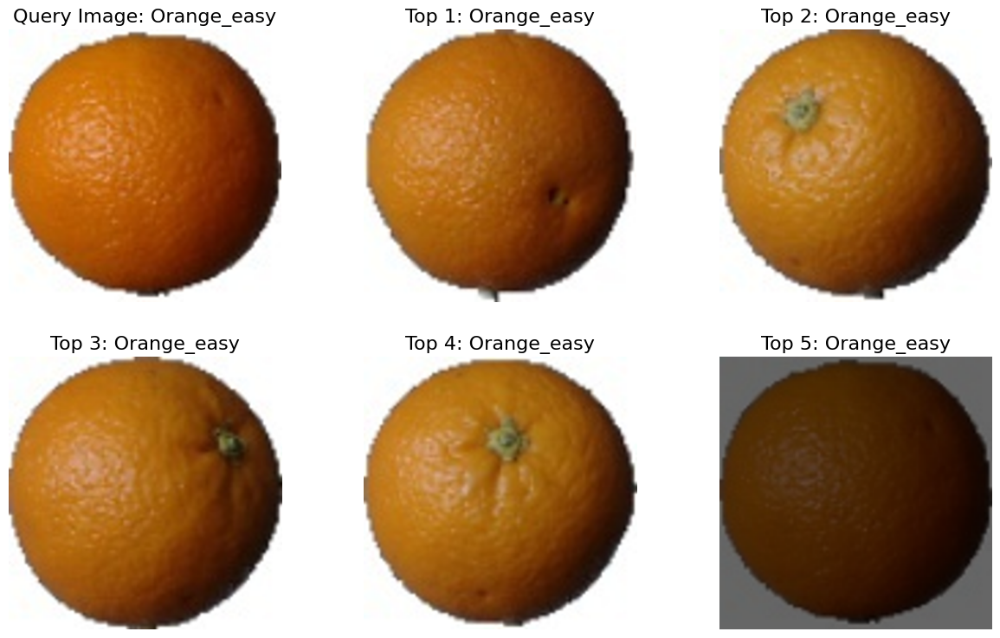

In [39]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_l2_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

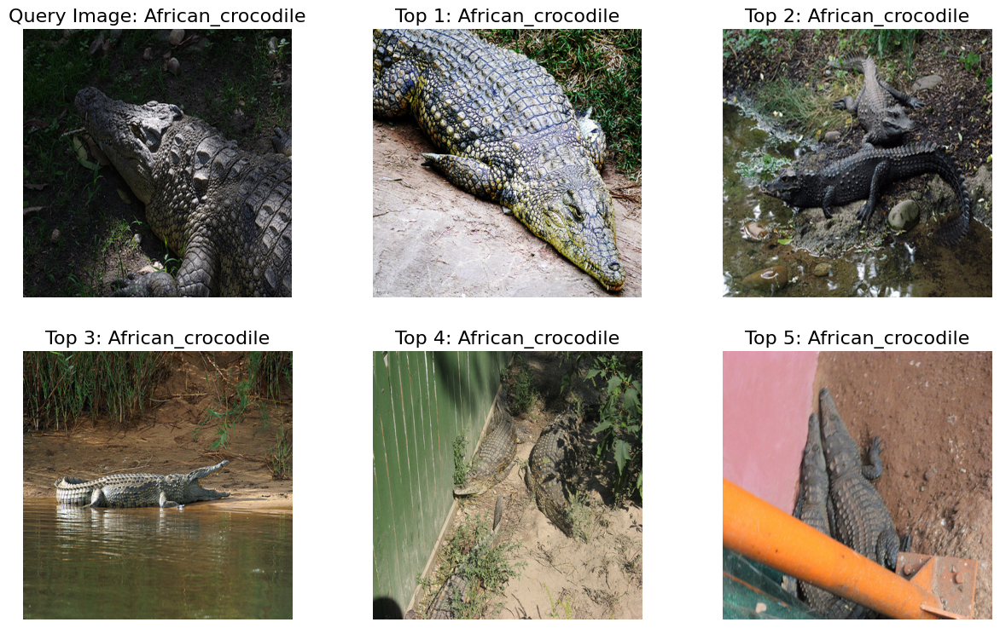

In [40]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_l2_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=False)

In [41]:
sorted(ls_path_score, key=lambda x: x[1])

[('data/train/African_crocodile/n01697457_10393.JPEG', 0.0005574191415707015),
 ('data/train/African_crocodile/n01697457_5586.JPEG', 0.000644206904439539),
 ('data/train/African_crocodile/n01697457_14906.JPEG', 0.0008739976962629822),
 ('data/train/African_crocodile/n01697457_1331.JPEG', 0.0010053340218349402),
 ('data/train/African_crocodile/n01697457_260.JPEG', 0.0010686452298834946),
 ('data/train/African_crocodile/n01697457_85.JPEG', 0.0011877696345934628),
 ('data/train/African_crocodile/n01697457_18587.JPEG', 0.001238204058326449),
 ('data/train/African_crocodile/n01697457_8136.JPEG', 0.0012929550305617965),
 ('data/train/ruffed_grouse/n01797886_17360.JPEG', 0.0013832840528097974),
 ('data/train/vine_snake/n01739381_5304.JPEG', 0.0015166323521372477),
 ('data/train/lynx/n02127052_3830.JPEG', 0.0015549621645660392),
 ('data/train/vine_snake/n01739381_5091.JPEG', 0.001560069371865144),
 ('data/train/triceratops/n01704323_541.JPEG', 0.0015795006419875536),
 ('data/train/vine_snake/n

## 2.5 Optimize cosine_similarity function

In [58]:
def get_cosine_similarity_score(root_img_path, query_path, size):
    query = read_image_from_path(query_path, size)
    query_embedding = get_single_image_embedding(query)
    ls_path_score = []

    for folder in os.listdir(root_img_path):
        if folder in CLASS_NAME:
            path = root_img_path + folder
            images_np, images_path = folder_to_images(path, size)
            embedding_list = []

            for idx_img in range(images_np.shape[0]):
                embedding = get_single_image_embedding(images_np[idx_img].astype(np.uint8))
                embedding_list.append(embedding)
            rates = cosine_similarity(query_embedding, np.stack(embedding_list))
            ls_path_score.extend(list(zip(images_path, rates)))

    return query, ls_path_score

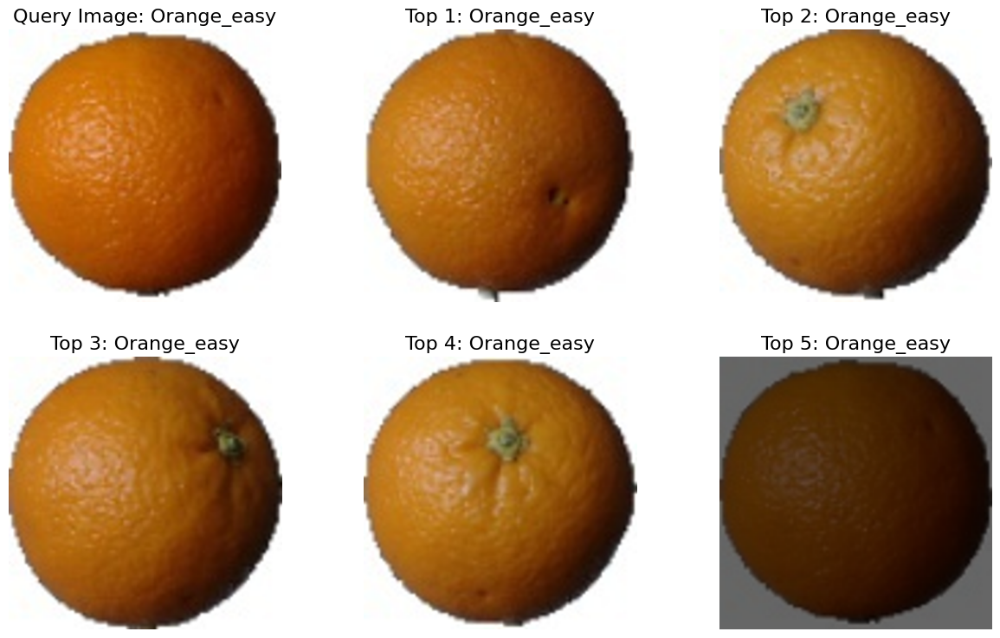

In [59]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_cosine_similarity_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=True)

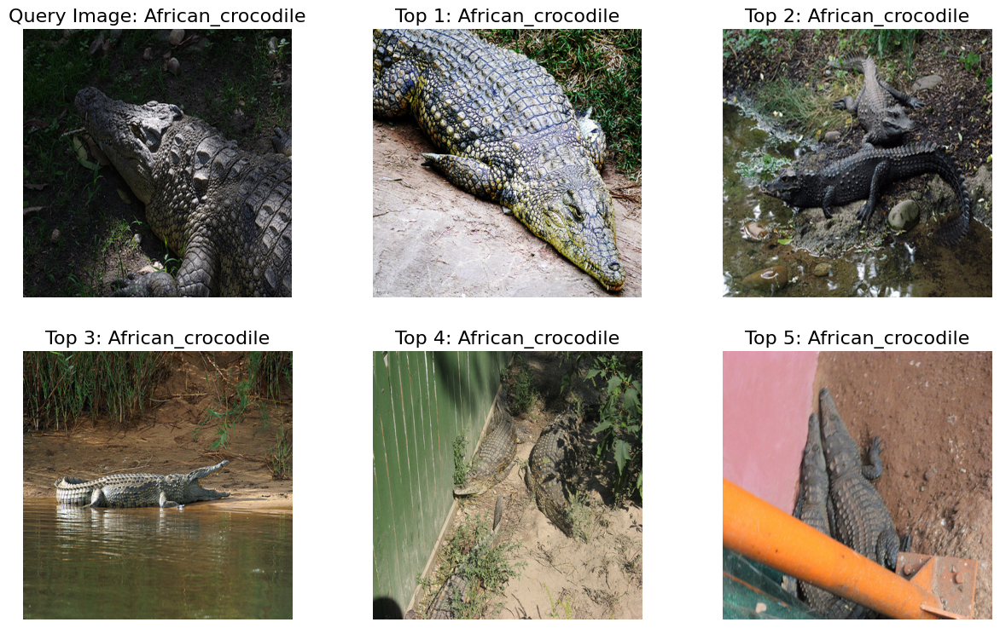

In [60]:
root_img_path = f"{ROOT}/train/"
query_path = f"{ROOT}/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_cosine_similarity_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=True)

In [62]:
sorted(ls_path_score, key=lambda x: x[1], reverse=True)

[('data/train/African_crocodile/n01697457_10393.JPEG', 0.8573007051477551),
 ('data/train/African_crocodile/n01697457_5586.JPEG', 0.8350830337367359),
 ('data/train/African_crocodile/n01697457_14906.JPEG', 0.776256577628838),
 ('data/train/African_crocodile/n01697457_1331.JPEG', 0.7426344688621004),
 ('data/train/African_crocodile/n01697457_260.JPEG', 0.7264268154716393),
 ('data/train/African_crocodile/n01697457_85.JPEG', 0.6959309790635745),
 ('data/train/African_crocodile/n01697457_18587.JPEG', 0.6830197771462296),
 ('data/train/African_crocodile/n01697457_8136.JPEG', 0.6690035281320735),
 ('data/train/ruffed_grouse/n01797886_17360.JPEG', 0.6458793078237367),
 ('data/train/vine_snake/n01739381_5304.JPEG', 0.611742114344603),
 ('data/train/lynx/n02127052_3830.JPEG', 0.6019296528302215),
 ('data/train/vine_snake/n01739381_5091.JPEG', 0.600622224443711),
 ('data/train/triceratops/n01704323_541.JPEG', 0.5956478545782589),
 ('data/train/vine_snake/n01739381_5245.JPEG', 0.5950490877406979

## 2.6 Update get_correlation_coefficient_score function

In [63]:
def get_correlation_coefficient_score(root_img_path, query_path, size):
  query = read_image_from_path(query_path, size)
  query_embedding = get_single_image_embedding(query)
  ls_path_score = []
  for folder in os.listdir(root_img_path):
    if folder in CLASS_NAME:
      path = root_img_path + folder
      images_np, images_path = folder_to_images(path, size)
      embedding_list = []

      for idx_img in range(images_np.shape[0]):
        embedding = get_single_image_embedding(images_np[idx_img].astype(np.uint8))
        embedding_list.append(embedding)

      rates = correlation_coefficient(query_embedding, np.stack(embedding_list))
      ls_path_score.extend(list(zip(images_path, rates)))

  return query, ls_path_score

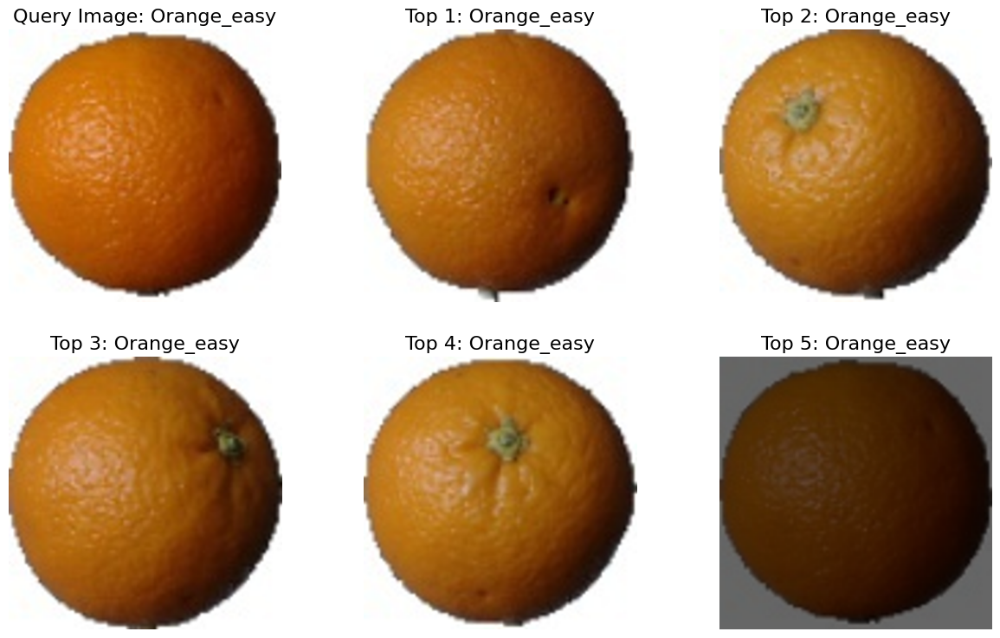

In [64]:
root_img_path = "data/train/"
query_path = "data/test/Orange_easy/0_100.jpg"
size = (448, 448)
query, ls_path_score = get_correlation_coefficient_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=True)

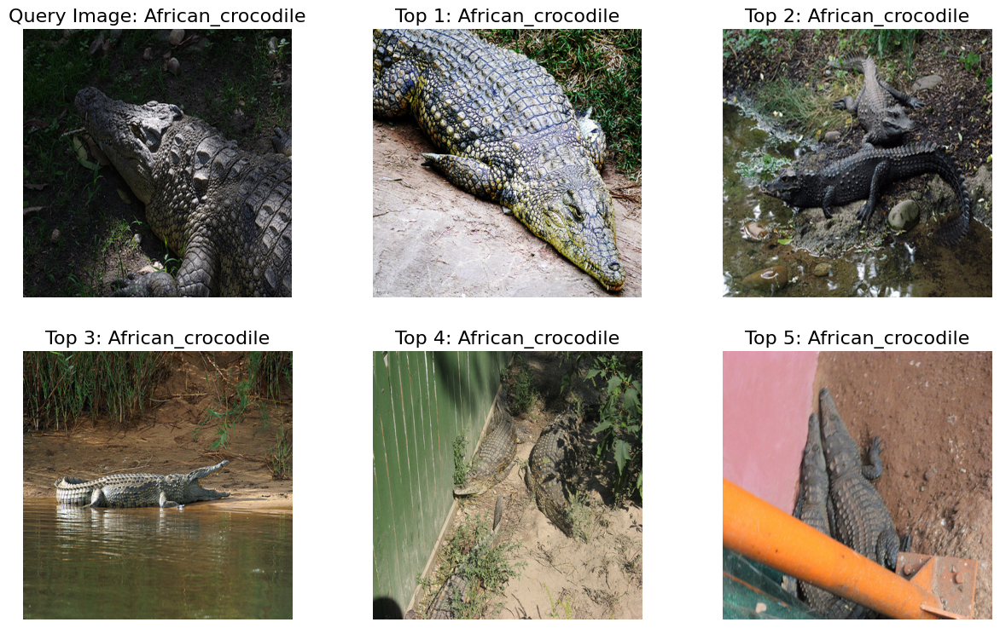

In [65]:
root_img_path = "data/train/"
query_path = "data/test/African_crocodile/n01697457_18534.JPEG"
size = (448, 448)
query, ls_path_score = get_correlation_coefficient_score(root_img_path, query_path, size)
plot_results(query_path, ls_path_score, reverse=True)

In [66]:
sorted(ls_path_score, key=lambda x: x[1], reverse=True)

[('data/train/African_crocodile/n01697457_10393.JPEG', 0.8569638652418415),
 ('data/train/African_crocodile/n01697457_5586.JPEG', 0.8345372066934486),
 ('data/train/African_crocodile/n01697457_14906.JPEG', 0.7759042827261455),
 ('data/train/African_crocodile/n01697457_1331.JPEG', 0.7422256231303844),
 ('data/train/African_crocodile/n01697457_260.JPEG', 0.7255695879575753),
 ('data/train/African_crocodile/n01697457_85.JPEG', 0.6951836863328119),
 ('data/train/African_crocodile/n01697457_18587.JPEG', 0.6819439501117542),
 ('data/train/African_crocodile/n01697457_8136.JPEG', 0.6695026399892046),
 ('data/train/ruffed_grouse/n01797886_17360.JPEG', 0.6457238621404611),
 ('data/train/vine_snake/n01739381_5304.JPEG', 0.6115895707011284),
 ('data/train/lynx/n02127052_3830.JPEG', 0.6006351026084628),
 ('data/train/vine_snake/n01739381_5091.JPEG', 0.5997228943750157),
 ('data/train/triceratops/n01704323_541.JPEG', 0.5943107891960776),
 ('data/train/vine_snake/n01739381_5245.JPEG', 0.5934611768472

# 3. Optimize query using CLIP and vector database

## 3.1 Necessary Function

In [67]:
def get_files_path(path):
  files_path = []

  for label in CLASS_NAME:
    label_path = path + '/' + label
    filenames = os.listdir(label_path)

    for filename in filenames:
      filepath = label_path + '/' + filename
      files_path.append(filepath)

  return files_path

data_path = f'{ROOT}/train'
files_path = get_files_path(path=data_path)

In [68]:
def add_embedding(collection, files_path):
    ids = []
    embeddings = []
    for id_filepath, filepath in tqdm(enumerate(files_path)):
        ids.append(f'id_{id_filepath}')
        image = Image.open(filepath)
        embedding = get_single_image_embedding(image=image)
        embeddings.append(embedding)
    collection.add(
        embeddings=embeddings,
        ids=ids
    )

In [74]:
def plot_results(image_path, files_path, results):
    query_image = Image.open(image_path).resize((448,448))
    images = [query_image]
    class_name = []

    for id_img in results['ids'][0]:
        id_img = int(id_img.split('_')[-1])
        img_path = files_path[id_img]
        img = Image.open(img_path).resize((448,448))
        images.append(img)
        class_name.append(img_path.split('/')[2])

    fig, axes = plt.subplots(2, 3, figsize=(12, 8))

    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i])
        if i == 0:
            ax.set_title(f"Query Image: {image_path.split('/')[2]}")
        else:
            ax.set_title(f"Top {i+1}: {class_name[i-1]}")
        ax.axis('off')
    plt.show()

## 3.2 Create a Chroma database and L2 Embedding Collection

In [71]:
chroma_client = chromadb.Client()

l2_collection = chroma_client.get_or_create_collection(name="l2_collection",
                                                       metadata={"hnsw:space": "l2"})

add_embedding(collection=l2_collection, files_path=files_path)

595it [02:50,  3.48it/s]


In [70]:
# Search image with L2 collection
def search(image_path, collection, n_results):
  query_image = Image.open(image_path)
  query_embedding = get_single_image_embedding(query_image)
  results = collection.query(query_embeddings=[query_embedding],
                             n_results=n_results)

  return results

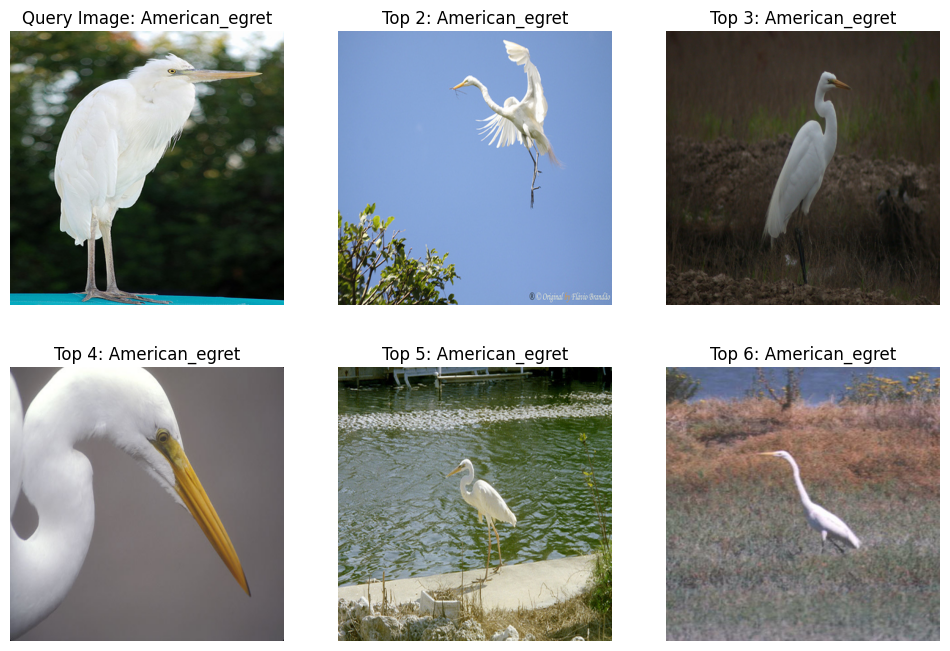

In [75]:
test_path = f'{ROOT}/test'
test_files_path = get_files_path(path=test_path)
test_path = test_files_path[1]
l2_results = search(image_path=test_path, collection=l2_collection, n_results=5)
plot_results(image_path=test_path, files_path=files_path, results=l2_results)

In [78]:
l2_results

{'ids': [['id_15', 'id_10', 'id_18', 'id_14', 'id_11']],
 'distances': [[0.40494874119758606,
   0.4122699201107025,
   0.5080230832099915,
   0.5198448896408081,
   0.5294203758239746]],
 'metadatas': [[None, None, None, None, None]],
 'embeddings': None,
 'documents': [[None, None, None, None, None]],
 'uris': None,
 'data': None,
 'included': ['metadatas', 'documents', 'distances']}

## 3.4 Query image with Consine Similarity Collection

In [76]:
cosine_collection = chroma_client.get_or_create_collection(name="cosine_collection",
                                                       metadata={"hnsw:space": "cosine"})

add_embedding(collection=cosine_collection, files_path=files_path)

595it [02:59,  3.32it/s]


In [77]:
def search(image_path, collection, n_results):
    query_image = Image.open(image_path)
    query_embedding = get_single_image_embedding(query_image)
    results = collection.query(
        query_embeddings=[query_embedding],
        n_results=n_results
    )
    return results

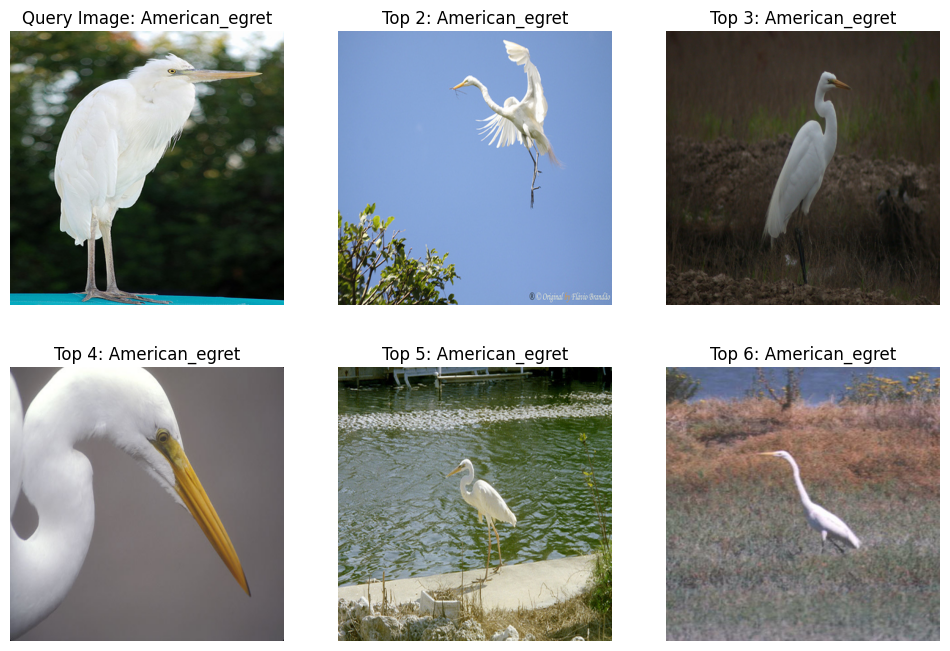

In [81]:
test_path = f'{ROOT}/test'
test_files_path = get_files_path(path=test_path)
test_path = test_files_path[1]
cosine_results = search(image_path=test_path, collection=cosine_collection, n_results=5)
plot_results(image_path=test_path, files_path=files_path, results=l2_results)

In [82]:
cosine_results

{'ids': [['id_15', 'id_10', 'id_18', 'id_14', 'id_11']],
 'distances': [[0.20247411727905273,
   0.20613503456115723,
   0.2540115714073181,
   0.25992196798324585,
   0.264710009098053]],
 'metadatas': [[None, None, None, None, None]],
 'embeddings': None,
 'documents': [[None, None, None, None, None]],
 'uris': None,
 'data': None,
 'included': ['metadatas', 'documents', 'distances']}